## This file is edited on colab below on each cell I have commented weather you can run it or not .

In [ ]:
#imported important libraries
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# You dont have to run this cell it is for colab just skip it.
## Mounting google drive
from google.colab import drive
drive.mount('gdrive')

Mounted at gdrive


In [ ]:
# Skip it also
%cd /content/gdrive/MyDrive/Colab DataSets/

/content/gdrive/MyDrive/Colab DataSets


In [ ]:
# Provide path to Clinic_data in your jupyter notebook
df = pd.read_csv('Clinic_data.csv')

In [ ]:
df.head()

NameError: ignored

In [ ]:
#They are 4920 rows, 133 columns
df.shape

NameError: ignored

In [ ]:
#seeing any null values are there with descending format
df.isnull().sum().sort_values(ascending=False)

itching                 0
spinning_movements      0
altered_sensorium       0
muscle_pain             0
irritability            0
                       ..
abdominal_pain          0
constipation            0
back_pain               0
pain_behind_the_eyes    0
prognosis               0
Length: 133, dtype: int64

In [ ]:
df.columns

Index(['itching', 'skin_rash', 'nodal_skin_eruptions', 'continuous_sneezing',
       'shivering', 'chills', 'joint_pain', 'stomach_pain', 'acidity',
       'ulcers_on_tongue',
       ...
       'blackheads', 'scurring', 'skin_peeling', 'silver_like_dusting',
       'small_dents_in_nails', 'inflammatory_nails', 'blister',
       'red_sore_around_nose', 'yellow_crust_ooze', 'prognosis'],
      dtype='object', length=133)

In [ ]:
#looking how much percent each diseases having
df['prognosis'].value_counts()

Fungal infection                           120
Hepatitis C                                120
Hepatitis E                                120
Alcoholic hepatitis                        120
Tuberculosis                               120
Common Cold                                120
Pneumonia                                  120
Dimorphic hemmorhoids(piles)               120
Heart attack                               120
Varicose veins                             120
Hypothyroidism                             120
Hyperthyroidism                            120
Hypoglycemia                               120
Osteoarthristis                            120
Arthritis                                  120
(vertigo) Paroymsal  Positional Vertigo    120
Acne                                       120
Urinary tract infection                    120
Psoriasis                                  120
Hepatitis D                                120
Hepatitis B                                120
Allergy      

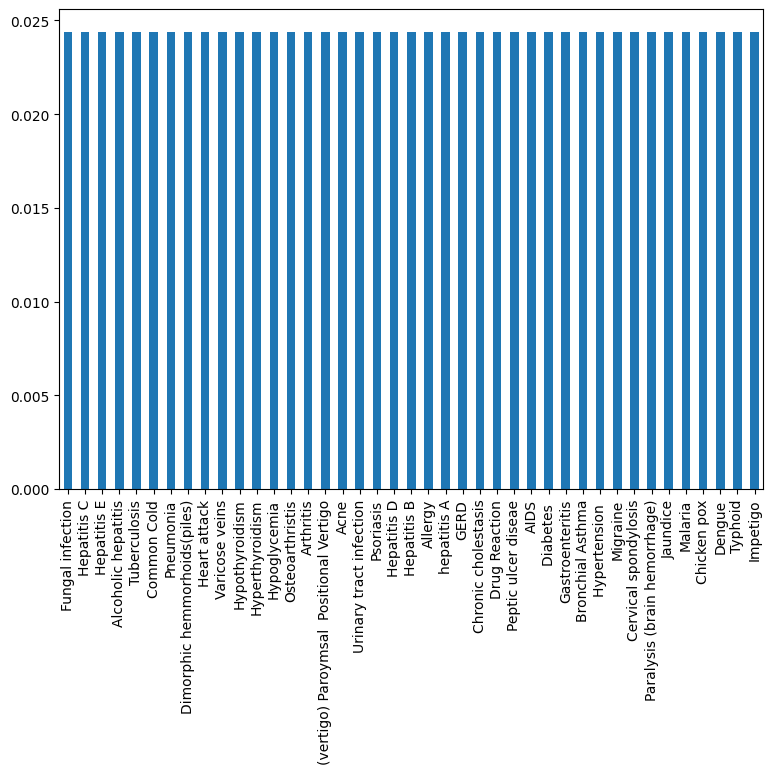

In [ ]:
#as we can see each no. diseases having the same percentage through bar chart
df['prognosis'].value_counts(normalize = True).plot.bar()
plt.subplots_adjust(left = 0.9, right = 2 , top = 2, bottom = 1)

In [ ]:
#checking if there are any other data types
df.dtypes.unique()

array([dtype('int64'), dtype('O')], dtype=object)

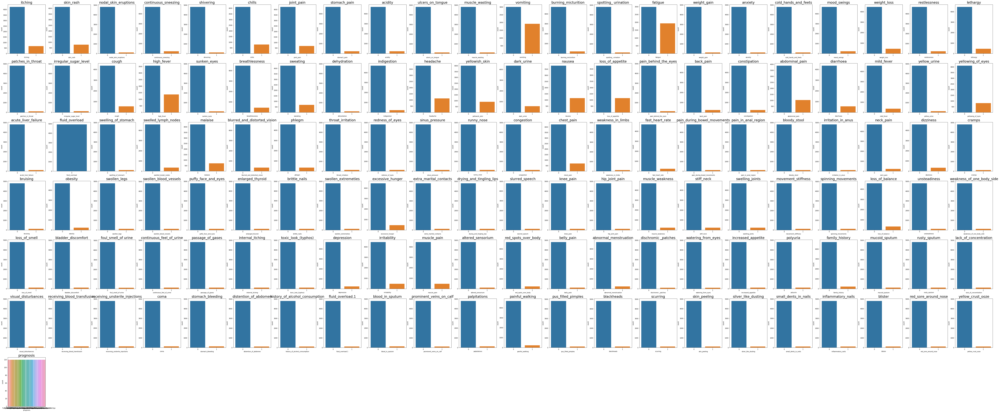

In [ ]:
#Analyzing each symptoms/variable
for x in range(df.shape[1]):
    plt.subplot(7,22,x+1)
    plt.subplots_adjust(left = 0.5, right = 16 , top = 10, bottom = 0.5)
    sns.countplot(df[df.columns[x]]).set_title(df.columns[x],fontsize=23)

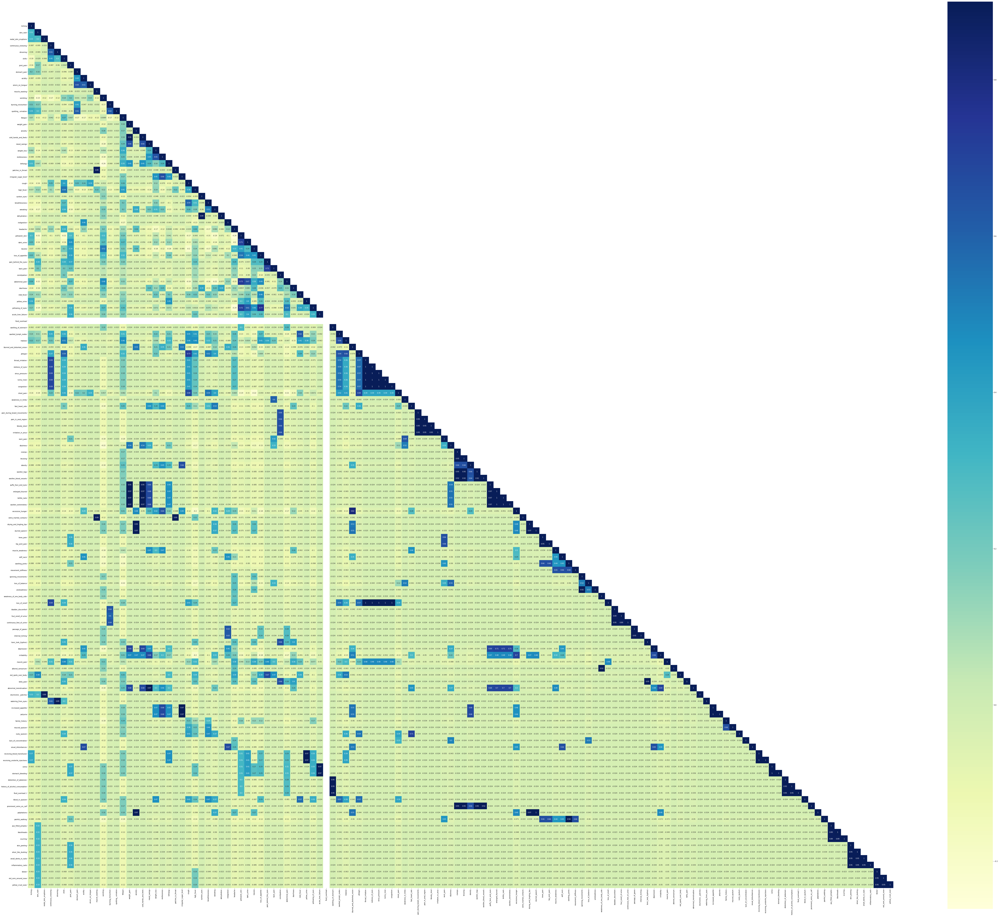

In [ ]:
#checking the relationship between the variables by applying the correlation
corr = df.corr()
mask = np.array(corr)
mask[np.tril_indices_from(mask)] = False
plt.subplots_adjust(left = 0.5, right = 16 , top = 20, bottom = 0.5)
sns.heatmap(corr, mask=mask,vmax=.9, square=True,annot=True, cmap="YlGnBu")

In [ ]:
#took two high correlation variables and analysing if it is satisfying null hypothesis or alternate hypothesis
pd.crosstab(df['cold_hands_and_feets'],df['weight_gain'])

weight_gain,0,1
cold_hands_and_feets,,
0,4800,6
1,6,108


In [ ]:
#imported the chi square contingency
from scipy.stats import chi2_contingency

In [ ]:
#as p value is  0.0  which is less than 0.05 then they are actually different from each other which satisfy the alternate hypothesis
chi2_contingency(pd.crosstab(df['cold_hands_and_feets'],df['weight_gain']))

(4362.40173527245, 0.0, 1, array([[4.69464146e+03, 1.11358537e+02],
        [1.11358537e+02, 2.64146341e+00]]))

In [ ]:
#seperated the independent and dependent values to repective variables
x = df.drop(['prognosis'],axis =1)
y = df['prognosis']

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
# Skip this cell
#divided into testing and training
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.33, random_state=42)

In [ ]:
#imported naive_baye algorithm
from sklearn.naive_bayes import MultinomialNB

In [ ]:
#fitted the model
mnb = MultinomialNB()
#mnb = mnb.fit(x_train, y_train)

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.model_selection import cross_val_score

In [ ]:
# Skip this cell
y_pred = mnb.predict(x_test)

In [ ]:
# Skip this cell
accuracy_score(y_pred,y_test)

1.0

In [ ]:
# Skip this cell
#by cross validating we got mean also 100%
scores = cross_val_score(mnb, x_test, y_test, cv=3)
print (scores)
print (scores.mean())

[1. 1. 1.]
1.0


In [ ]:
# Skip this cell
real_diseases = y_test.values

In [ ]:
# Skip this cell
#for the cross checking purpose i want to see if predicted values and actual values are same else it gives me worng prediction
for i in range(0, len(real_diseases)):
    if y_pred[i] == real_diseases[i]:
        print ('Pred: {0} Actual:{1}'.format(y_pred[i], real_diseases[i]))
    else:
        print('worng prediction')
        print ('Pred: {0} Actual:{1}'.format(y_pred[i], real_diseases[i]))

Pred: Acne Actual:Acne
Pred: Acne Actual:Acne
Pred: Hyperthyroidism Actual:Hyperthyroidism
Pred: AIDS Actual:AIDS
Pred: Chronic cholestasis Actual:Chronic cholestasis
Pred: Hypertension  Actual:Hypertension 
Pred: Hypoglycemia Actual:Hypoglycemia
Pred: Arthritis Actual:Arthritis
Pred: Hepatitis B Actual:Hepatitis B
Pred: Migraine Actual:Migraine
Pred: Urinary tract infection Actual:Urinary tract infection
Pred: Diabetes  Actual:Diabetes 
Pred: Hepatitis D Actual:Hepatitis D
Pred: Psoriasis Actual:Psoriasis
Pred: Alcoholic hepatitis Actual:Alcoholic hepatitis
Pred: Alcoholic hepatitis Actual:Alcoholic hepatitis
Pred: Dimorphic hemmorhoids(piles) Actual:Dimorphic hemmorhoids(piles)
Pred: Hepatitis E Actual:Hepatitis E
Pred: Diabetes  Actual:Diabetes 
Pred: Cervical spondylosis Actual:Cervical spondylosis
Pred: Bronchial Asthma Actual:Bronchial Asthma
Pred: hepatitis A Actual:hepatitis A
Pred: Hepatitis B Actual:Hepatitis B
Pred: Bronchial Asthma Actual:Bronchial Asthma
Pred: Allergy Actu

In [ ]:
#imported Kfold
from sklearn.model_selection import KFold

In [ ]:
# Skip this cell
## Function to run multiple algorithms with different K values of KFold.
def evaluate(train_data,kmax,algo):
    test_scores = {}
    train_scores = {}
    for i in range(2,kmax,2):
        kf = KFold(n_splits = i)
        sum_train = 0
        sum_test = 0
        data = df
        for train,test in kf.split(data):
            train_data = data.iloc[train,:]
            test_data = data.iloc[test,:]
            x_train = train_data.drop(["prognosis"],axis=1)
            y_train = train_data['prognosis']
            x_test = test_data.drop(["prognosis"],axis=1)
            y_test = test_data["prognosis"]
            algo_model = algo.fit(x_train,y_train)
            sum_train += algo_model.score(x_train,y_train)
            y_pred = algo_model.predict(x_test)
            sum_test += accuracy_score(y_test,y_pred)
        average_test = sum_test/i
        average_train = sum_train/i
        test_scores[i] = average_test
        train_scores[i] = average_train
        print("kvalue: ",i)
    return(train_scores,test_scores)

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier
gbm = GradientBoostingClassifier()
nb = MultinomialNB()
from sklearn.linear_model import LogisticRegression
log = LogisticRegression()
from sklearn.tree import DecisionTreeClassifier
dt = DecisionTreeClassifier(criterion='entropy',)
from sklearn.ensemble import RandomForestClassifier
ran = RandomForestClassifier(n_estimators = 10)

In [ ]:
# Skip this cell
algo_dict = {'l_o_g':log,'d_t':dt,'r_a_n':ran,'N_B' : nb}
algo_train_scores={}
algo_test_scores={}

In [ ]:
# Skip this cell
#decision tree was found to be best fit with training score of 0.1 and testing score of 0.87 with k value of 2 in the k fold cross validation. All the other algorithm seems to be overfit.
max_kfold = 11
for algo_name in algo_dict.keys():
    print(algo_name)
    tr_score,tst_score = evaluate(df,max_kfold,algo_dict[algo_name])
    algo_train_scores[algo_name] = tr_score
    algo_test_scores[algo_name] = tst_score
print(algo_train_scores)
print(algo_test_scores)

l_o_g
kvalue:  2
kvalue:  4
kvalue:  6
kvalue:  8
kvalue:  10
d_t
kvalue:  2
kvalue:  4
kvalue:  6
kvalue:  8
kvalue:  10
r_a_n
kvalue:  2
kvalue:  4
kvalue:  6
kvalue:  8
kvalue:  10
N_B
kvalue:  2
kvalue:  4
kvalue:  6
kvalue:  8
kvalue:  10
{'l_o_g': {2: 1.0, 4: 1.0, 6: 1.0, 8: 1.0, 10: 1.0}, 'd_t': {2: 1.0, 4: 1.0, 6: 1.0, 8: 1.0, 10: 1.0}, 'r_a_n': {2: 1.0, 4: 1.0, 6: 1.0, 8: 1.0, 10: 1.0}, 'N_B': {2: 1.0, 4: 1.0, 6: 1.0, 8: 1.0, 10: 1.0}}
{'l_o_g': {2: 1.0, 4: 1.0, 6: 1.0, 8: 1.0, 10: 1.0}, 'd_t': {2: 0.8719512195121951, 4: 1.0, 6: 1.0, 8: 1.0, 10: 1.0}, 'r_a_n': {2: 0.998780487804878, 4: 1.0, 6: 1.0, 8: 1.0, 10: 1.0}, 'N_B': {2: 1.0, 4: 1.0, 6: 1.0, 8: 1.0, 10: 1.0}}


In [ ]:
# Skip this cell
df_test = pd.DataFrame(algo_test_scores)
df_train = pd.DataFrame(algo_train_scores)

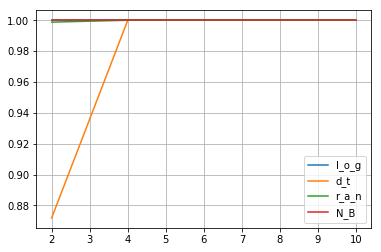

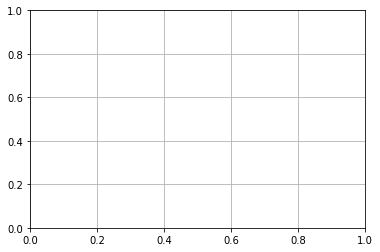

In [ ]:
# Skip this cell
df_test.plot(grid = 1)
plt.show()
plt.grid()

In [ ]:
# Skip this cell
#building the model at k value 2
test_scores={}
train_scores={}
train_d = 0
test_d = 0
y_tr = 0
y_te = 0

for i in range(2,4,2):
    kf = KFold(n_splits = i)
    sum_train = 0
    sum_test = 0
    data = df
    for train,test in kf.split(data):
        train_data = data.iloc[train,:]
        test_data = data.iloc[test,:]
        x_train = train_data.drop(["prognosis"],axis=1)
        train_d = x_train
        y_train = train_data['prognosis']
        y_tr = y_train
        x_test = test_data.drop(["prognosis"],axis=1)
        test_d = x_test
        y_test = test_data["prognosis"]
        y_te = y_test
        algo_model = dt.fit(x_train,y_train)
        sum_train += dt.score(x_train,y_train)
        y_pred = dt.predict(x_test)
        sum_test += accuracy_score(y_test,y_pred)
    average_test = sum_test/i
    average_train = sum_train/i
    test_scores[i] = average_test
    train_scores[i] = average_train
    print("kvalue: ",i)

kvalue:  2


In [ ]:
# Skip this cell
print(train_scores)
print(test_scores)

{2: 1.0}
{2: 0.8768292682926829}


In [ ]:
# Here we are training the same model that preson have done before with similar accuracy

from sklearn.model_selection import train_test_split
train_scores = {}
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.33, random_state=42)
dt.fit(x_train, y_train)
y_pred = dt.predict(x_train)

from sklearn.metrics import accuracy_score , confusion_matrix , classification_report
acc = accuracy_score(y_train , y_pred)
print("Accuracy : {:.3f}%".format(acc))

Accuracy : 1.000%


In [ ]:
len(x_train)

3296

In [ ]:
import sklearn
seed = 7
kfold = sklearn.model_selection.KFold(n_splits=3296)

from sklearn.model_selection import cross_val_score
accuracies = cross_val_score(estimator = dt, X = x_train,\
     y = y_train, cv = kfold)
print("Accuracy Mean {} Accuracy Variance \
     {}".format(accuracies.mean(),accuracies.std()))
accuracies

Accuracy Mean 0.9993932038834952 Accuracy Variance      0.02462575714527066


array([1., 1., 1., ..., 1., 1., 1.])

In [ ]:
seed = 7
kfold = sklearn.model_selection.KFold(n_splits=5)

from sklearn.model_selection import cross_val_score
accuracies = cross_val_score(estimator = dt, X = x_train,\
     y = y_train, cv = kfold)
print("Accuracy Mean {} Accuracy Variance \
     {}".format(accuracies.mean(),accuracies.std()))
accuracies

Accuracy Mean 0.9951459971490321 Accuracy Variance      0.001768377990206224


array([0.99393939, 0.99241275, 0.9969651 , 0.9969651 , 0.99544765])

In [ ]:
# Sample prediction
sample = dt.predict(np.array(x_test.iloc[3,:]).reshape(1,-1))
print(sample)
probs = dt.predict_proba(np.array(x_test.iloc[3,:]).reshape(1,-1))
print(probs)
print(y_test.iloc[3])
dt.classes_

['AIDS']
[[0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
AIDS


array(['(vertigo) Paroymsal  Positional Vertigo', 'AIDS', 'Acne',
       'Alcoholic hepatitis', 'Allergy', 'Arthritis', 'Bronchial Asthma',
       'Cervical spondylosis', 'Chicken pox', 'Chronic cholestasis',
       'Common Cold', 'Dengue', 'Diabetes ',
       'Dimorphic hemmorhoids(piles)', 'Drug Reaction',
       'Fungal infection', 'GERD', 'Gastroenteritis', 'Heart attack',
       'Hepatitis B', 'Hepatitis C', 'Hepatitis D', 'Hepatitis E',
       'Hypertension ', 'Hyperthyroidism', 'Hypoglycemia',
       'Hypothyroidism', 'Impetigo', 'Jaundice', 'Malaria', 'Migraine',
       'Osteoarthristis', 'Paralysis (brain hemorrhage)',
       'Peptic ulcer diseae', 'Pneumonia', 'Psoriasis', 'Tuberculosis',
       'Typhoid', 'Urinary tract infection', 'Varicose veins',
       'hepatitis A'], dtype=object)

In [ ]:
# install lime in your jupyter
!pip install lime

In [ ]:
import lime
from lime import lime_tabular

In [ ]:
class_names_test = ['.'.join(x.split('.')) for x in y_test]
class_names_train = ['.'.join(x.split('.')) for x in y_train]
class_names_test

['Acne',
 'Acne',
 'Hyperthyroidism',
 'AIDS',
 'Chronic cholestasis',
 'Hypertension ',
 'Hypoglycemia',
 'Arthritis',
 'Hepatitis B',
 'Migraine',
 'Urinary tract infection',
 'Diabetes ',
 'Hepatitis D',
 'Psoriasis',
 'Alcoholic hepatitis',
 'Alcoholic hepatitis',
 'Dimorphic hemmorhoids(piles)',
 'Hepatitis E',
 'Diabetes ',
 'Cervical spondylosis',
 'Bronchial Asthma',
 'hepatitis A',
 'Hepatitis B',
 'Bronchial Asthma',
 'Allergy',
 'Hepatitis C',
 'Pneumonia',
 'Migraine',
 'Hypothyroidism',
 'Migraine',
 'Chronic cholestasis',
 'Hepatitis B',
 'Gastroenteritis',
 'Hepatitis E',
 'Varicose veins',
 'Migraine',
 'Jaundice',
 'Drug Reaction',
 'Pneumonia',
 'Urinary tract infection',
 'Hepatitis C',
 '(vertigo) Paroymsal  Positional Vertigo',
 'Hypertension ',
 'Diabetes ',
 'Jaundice',
 'Gastroenteritis',
 'Hypoglycemia',
 'Hepatitis B',
 'Psoriasis',
 'Psoriasis',
 'Heart attack',
 'Tuberculosis',
 'Varicose veins',
 'Allergy',
 'Hyperthyroidism',
 'Hepatitis C',
 'Typhoid',
 '

In [ ]:
y_test

373                    Acne
4916                   Acne
1550        Hyperthyroidism
3081                   AIDS
3857    Chronic cholestasis
               ...         
1257                   GERD
3346           Tuberculosis
3384            Hepatitis D
3290          Hypertension 
1178              Arthritis
Name: prognosis, Length: 1624, dtype: object

In [ ]:
# Building lime interpretor to understand/interpret our machine learning model

interpretor = lime_tabular.LimeTabularExplainer(
                               training_data = np.array(x_train),
                               feature_names = x_train.columns,
                               class_names=dt.classes_,
                               mode = 'classification')

In [ ]:
# Resetting indexes
x_test.reset_index(drop = True, inplace = True)
x_train.reset_index(drop = True, inplace = True)
x_test.head(4)

,itching,skin_rash,nodal_skin_eruptions,continuous_sneezing,shivering,chills,joint_pain,stomach_pain,acidity,ulcers_on_tongue,...,pus_filled_pimples,blackheads,scurring,skin_peeling,silver_like_dusting,small_dents_in_nails,inflammatory_nails,blister,red_sore_around_nose,yellow_crust_ooze
0,0,1,0,0,0,0,0,0,0,0,...,0,1,1,0,0,0,0,0,0,0
1,0,1,0,0,0,0,0,0,0,0,...,1,1,1,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
from numpy import random

In [ ]:
# Here we are taking random data from training dataset and analyzing the machine learning model using Lime
idx = random.randint(1, len(x_train))
print(idx)

print("Prediction : ", [dt.predict(np.array(x_train.iloc[idx,:]).reshape(1,-1))][0])
print("Actual Label : ", class_names_train[idx],"\n")

exp = interpretor.explain_instance(
            data_row  = np.array(x_train.iloc[idx,:]).reshape(1,-1)[0],
            predict_fn = dt.predict_proba,
            num_features = 15, # you can change this number read description below
            top_labels = 1
)
exp.show_in_notebook(show_table = True)

# Below you can see our ML model ( decision Tree ) predicted Jaundice given a random
# sample of data and the prediction is true as per the actual label of that sample
# Lime interpretor shows us which features are affecting our ML model to declare
# this sample as Jaundice below we have Jaundice and Not Jaundice columns which
# shows that majority of features are on the side of Jaundice sorted by thier importance
# in decsending order. For reference I have only 15 features out of 133 to check
# how they are affecting our ML model positively/negatively sorted in descending order.
# You can change number of features above 15,25,30 etc . The table shows the features
# highlighed weather they are good for right prediction or not. Lime interpretor
# shows us and explained how our Decision tree is working which features it is taking
# as good or bad.

2148
Prediction :  ['Jaundice']
Actual Label :  Jaundice 



In [ ]:
# Here we are taking random example from testing data to check Lime interpretor

idx = random.randint(1, len(x_test))
print(idx)

print("Prediction : ", [dt.predict(np.array(x_test.iloc[idx,:]).reshape(1,-1))][0])
print("Actual Label : ", class_names_test[idx],"\n")

exp = interpretor.explain_instance(
            data_row  = np.array(x_test.iloc[idx,:]).reshape(1,-1)[0],
            predict_fn = dt.predict_proba,
            num_features = 15,
            top_labels = 1
)
exp.show_in_notebook(show_table = True)

# We can clearly see that most features are on the side of heart attact thus our
# Decision Tree model accurately predicted the sample data.

1383
Prediction :  ['Heart attack']
Actual Label :  Heart attack 



## Naive Bais Algorithm

In [ ]:
nb.fit(x_train, y_train)
y_pred_nb = nb.predict(x_train)

acc = accuracy_score(y_train , y_pred_nb)
print("Accuracy : {:.3f}%".format(acc))

Accuracy : 1.000%


In [ ]:
seed = 7
kfold = sklearn.model_selection.KFold(n_splits=5)

from sklearn.model_selection import cross_val_score
accuracies = cross_val_score(estimator = nb, X = x_train,\
     y = y_train, cv = kfold)
print("Accuracy Mean {} Accuracy Variance \
     {}".format(accuracies.mean(),accuracies.std()))
accuracies

Accuracy Mean 1.0 Accuracy Variance      0.0


array([1., 1., 1., 1., 1.])

In [ ]:
interpretor = lime_tabular.LimeTabularExplainer(
                               training_data = np.array(x_train),
                               feature_names = x_train.columns,
                               class_names=nb.classes_,
                               mode = 'classification')

In [ ]:
# Here we are taking random data from training dataset and analyzing the machine learning model using Lime
idx = random.randint(1, len(x_train))
print(idx)

print("Prediction : ", [nb.predict(np.array(x_train.iloc[idx,:]).reshape(1,-1))][0])
print("Actual Label : ", class_names_train[idx],"\n")

exp = interpretor.explain_instance(
            data_row  = np.array(x_train.iloc[idx,:]).reshape(1,-1)[0],
            predict_fn = nb.predict_proba,
            num_features = 15, # you can change this number read description below
            top_labels = 1
)
exp.show_in_notebook(show_table = True)


1529
Prediction :  ['Allergy']
Actual Label :  Allergy 



In [ ]:
# Here we are taking random example from testing data to check Lime interpretor

idx = random.randint(1, len(x_test))
print(idx)

print("Prediction : ", [nb.predict(np.array(x_test.iloc[idx,:]).reshape(1,-1))][0])
print("Actual Label : ", class_names_test[idx],"\n")

exp = interpretor.explain_instance(
            data_row  = np.array(x_test.iloc[idx,:]).reshape(1,-1)[0],
            predict_fn = nb.predict_proba,
            num_features = 15,
            top_labels = 1
)
exp.show_in_notebook(show_table = True)


1042
Prediction :  ['Acne']
Actual Label :  Acne 



## Training Neural networks

In [ ]:
import sklearn
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense , BatchNormalization
from sklearn.model_selection import train_test_split

print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)
n_features = x_train.shape[1]
n_features

(3296, 132)
(3296,)
(1624, 132)
(1624,)


132

In [ ]:
from sklearn.preprocessing import LabelEncoder

encoder = LabelEncoder()
y_train_new = encoder.fit_transform(y_train)
print(y_train_new)
print(y_train_new.shape)

[ 9 20 18 ... 11 15 14]
(3296,)


In [ ]:
print(len(encoder.classes_))
#print(encoder.inverse_transform(np.array(21)))

41


In [ ]:
from tensorflow.keras import Sequential

model = Sequential()
model.add(Dense(7, activation='relu', kernel_initializer='he_normal', input_shape=(n_features,)))
model.add(Dense(6, activation='relu', kernel_initializer='he_normal'))
model.add(Dense(5, activation='relu', kernel_initializer='he_normal'))
model.add(Dense(41, activation='softmax'))

In [ ]:
model.compile(
        optimizer='adam',
        loss='sparse_categorical_crossentropy',
        metrics=['accuracy'])


In [ ]:
# fit the model
%time
print(x_train.shape)
model.fit(x_train, y_train_new, epochs=9, batch_size=32, verbose=2)

CPU times: user 2 µs, sys: 0 ns, total: 2 µs
Wall time: 5.01 µs
(3296, 132)
Epoch 1/9
103/103 - 6s - loss: 3.6817 - accuracy: 0.0352 - 6s/epoch - 61ms/step
Epoch 2/9
103/103 - 0s - loss: 3.4100 - accuracy: 0.0640 - 241ms/epoch - 2ms/step
Epoch 3/9
103/103 - 0s - loss: 2.8929 - accuracy: 0.1280 - 247ms/epoch - 2ms/step
Epoch 4/9
103/103 - 0s - loss: 2.3618 - accuracy: 0.2637 - 261ms/epoch - 3ms/step
Epoch 5/9
103/103 - 0s - loss: 1.8448 - accuracy: 0.4175 - 246ms/epoch - 2ms/step
Epoch 6/9
103/103 - 0s - loss: 1.4054 - accuracy: 0.5634 - 249ms/epoch - 2ms/step
Epoch 7/9
103/103 - 0s - loss: 1.0498 - accuracy: 0.6544 - 247ms/epoch - 2ms/step
Epoch 8/9
103/103 - 0s - loss: 0.7335 - accuracy: 0.8146 - 257ms/epoch - 2ms/step
Epoch 9/9
103/103 - 0s - loss: 0.4678 - accuracy: 0.9533 - 245ms/epoch - 2ms/step


In [ ]:
from numpy import random
idx = random.randint(1, len(x_train))
print(idx)

prediction = [model.predict(np.array(x_train.iloc[idx,:]).reshape(1,-1))][0]
print("Prediction : ", np.argmax(prediction,axis=1))


3155


NameError: ignored

In [ ]:
interpretor = lime_tabular.LimeTabularExplainer(
                               training_data = np.array(x_train),
                               feature_names = x_train.columns,
                               class_names=encoder.classes_,
                               mode = 'classification')

In [ ]:
# Here we are taking random data from training dataset and analyzing the machine learning model using Lime
idx = random.randint(1, len(x_train))
print(idx)

prediction = np.argmax([model.predict(np.array(x_train.iloc[idx,:]).reshape(1,-1))][0],axis=1)
print("Prediction actual ", prediction,"\n", "Prediction label ", encoder.inverse_transform(prediction))
print("Actual Label : ", class_names_train[idx],"\n")

exp = interpretor.explain_instance(
            data_row  = np.array(x_train.iloc[idx,:]).reshape(1,-1)[0],
            predict_fn = model.predict,
            num_features = 15, # you can change this number read description below
            top_labels = 1
)
exp.show_in_notebook(show_table = True)


1796
1/1 [==============================] - 0s 20ms/step
Prediction actual  [6] 
 Prediction label  ['Bronchial Asthma']
Actual Label :  Bronchial Asthma 

157/157 [==============================] - 0s 1ms/step


In [ ]:
# Here we are taking random data from testing dataset and analyzing the machine learning model using Lime
idx = random.randint(1, len(x_test))
print(idx)

prediction = np.argmax([model.predict(np.array(x_test.iloc[idx,:]).reshape(1,-1))][0],axis=1)
print("Prediction actual ", prediction,"\n", "Prediction label ", encoder.inverse_transform(prediction))
print("Actual Label : ", class_names_test[idx],"\n")

exp = interpretor.explain_instance(
            data_row  = np.array(x_test.iloc[idx,:]).reshape(1,-1)[0],
            predict_fn = model.predict,
            num_features = 15, # you can change this number read description below
            top_labels = 1
)
exp.show_in_notebook(show_table = True)


661
1/1 [==============================] - 0s 19ms/step
Prediction actual  [33] 
 Prediction label  ['Peptic ulcer diseae']
Actual Label :  Paralysis (brain hemorrhage) 

157/157 [==============================] - 0s 2ms/step


## Testing all algorithms on new data

In [ ]:
#prediction = np.argmax([model.predict(np.array(x_train.iloc[idx,:]).reshape(1,-1))][0],axis=1)
#encoder.inverse_transform(prediction)
idx = random.randint(1, len(x_test))

print(idx)
np.array(x_train.iloc[idx,:]).reshape(1,-1)


154


array([[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]])

In [ ]:
valid_rows = df[df.eq(1).sum(axis=1) >= 4]
random_records = valid_rows.sample(n=4, random_state=random.seed())
random_records

,itching,skin_rash,nodal_skin_eruptions,continuous_sneezing,shivering,chills,joint_pain,stomach_pain,acidity,ulcers_on_tongue,...,scurring,skin_peeling,silver_like_dusting,small_dents_in_nails,inflammatory_nails,blister,red_sore_around_nose,yellow_crust_ooze,prognosis,count_ones
154,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,Malaria,7
772,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,(vertigo) Paroymsal Positional Vertigo,5
2193,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,Jaundice,7
251,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,Tuberculosis,16


In [ ]:
selected_features = random_records.loc[:, (random_records == 1).any()]
selected_features

In [ ]:
record = selected_features.iloc[2]
filtered_record = record[record == 1]

# Convert the filtered record to a tuple with (feature_name, value)
record_tuple = tuple(zip(filtered_record.index, filtered_record.values))

# Display the record tuple
print(record_tuple)

(('itching', 1), ('fatigue', 1), ('weight_loss', 1), ('high_fever', 1), ('yellowish_skin', 1), ('dark_urine', 1), ('abdominal_pain', 1))


In [ ]:
## Step 1

sample_dict = {}
feature_list = list(x_train.columns)
for i in feature_list:
  sample_dict[i] = 0

l1 = ["vomiting", "headache", "weakness_of_one_body_side", "altered_sensorium"]
l2 = [1, 1, 1, 1]

for i,j in zip(l1,l2):
  sample_dict[i] = j

sam_arr = np.array(list(sample_dict.values())).reshape(1,-1)
sam_arr

array([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]])

In [ ]:
#prediction = np.argmax([model.predict(sam_arr)][0],axis=1)
#encoder.inverse_transform(prediction)


In [ ]:
# Saving NN model

saved_model_path = "clinic_NN_model.h5"
#model.save(saved_model_path)


In [ ]:
## Step 2

reloaded_model = tf.keras.models.load_model(saved_model_path)
prediction = np.argmax([reloaded_model.predict(sam_arr)][0],axis=1)


1/1 [==============================] - 0s 58ms/step


In [ ]:
## Step 3

#np.save('classes.npy', encoder.classes_)

from sklearn.preprocessing import LabelEncoder
encd = LabelEncoder()
encd.classes_ = np.load('classes.npy', allow_pickle = True)
print(encd.classes_)
encd.inverse_transform(prediction)


['(vertigo) Paroymsal  Positional Vertigo' 'AIDS' 'Acne'
 'Alcoholic hepatitis' 'Allergy' 'Arthritis' 'Bronchial Asthma'
 'Cervical spondylosis' 'Chicken pox' 'Chronic cholestasis' 'Common Cold'
 'Dengue' 'Diabetes ' 'Dimorphic hemmorhoids(piles)' 'Drug Reaction'
 'Fungal infection' 'GERD' 'Gastroenteritis' 'Heart attack' 'Hepatitis B'
 'Hepatitis C' 'Hepatitis D' 'Hepatitis E' 'Hypertension '
 'Hyperthyroidism' 'Hypoglycemia' 'Hypothyroidism' 'Impetigo' 'Jaundice'
 'Malaria' 'Migraine' 'Osteoarthristis' 'Paralysis (brain hemorrhage)'
 'Peptic ulcer diseae' 'Pneumonia' 'Psoriasis' 'Tuberculosis' 'Typhoid'
 'Urinary tract infection' 'Varicose veins' 'hepatitis A']


array(['Paralysis (brain hemorrhage)'], dtype=object)

In [ ]:
!pip install lime

In [ ]:
import lime
from lime import lime_tabular

In [ ]:
np.array(x_train)

array([[1, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 1, 0, ..., 0, 0, 0],
       [1, 1, 1, ..., 0, 0, 0],
       [1, 1, 0, ..., 0, 0, 0]])

In [ ]:
interpretor = lime_tabular.LimeTabularExplainer(
                               training_data = np.array(x_train),
                               feature_names = x_train.columns,
                               class_names=encd.classes_,
                               mode = 'classification')

In [ ]:
pip install dill


In [ ]:
import dill

#with open('lime_interpretor.pkl', 'wb') as f:
 #   dill.dump(interpretor, f)

# For loading

with open('lime_interpretor.pkl', 'rb') as f:
   new_interpretor1 = dill.load(f)


In [ ]:
pd.__version__
#pickle.__version__

'1.5.3'

In [ ]:
"""
sam_arr1 = sam_arr[0]

# Map the feature names to their corresponding indexes in the explainer's feature_names
feature_indexes = [interpretor.feature_names.index(feature_name) for feature_name in l1]

# Create a mask to select the relevant features
mask = [True if i in feature_indexes else False for i in range(len(interpretor.feature_names))]

# Apply the mask to the explainer object
reduced_explainer = lime.lime_tabular.LimeTabularExplainer(sam_arr[:, mask],
                                                           feature_names=[interpretor.feature_names[i] for i in feature_indexes],
                                                           class_names=interpretor.class_names)

# Adjust the shape of the new instance by concatenating zeros for the remaining features
new_instance_adjusted = np.concatenate((sam_arr1[mask], np.zeros(len(interpretor.feature_names) - len(l1))), axis=0)


# Get the explanation for the new instance using the reduced explainer
explanation = reduced_explainer.explain_instance(new_instance_adjusted, reloaded_model.predict)


prediction = np.argmax([reloaded_model.predict(sam_arr)][0],axis=1)
print("Prediction actual ", prediction,"\n", "Prediction label ", encd.inverse_transform(prediction))
"""
exp1 = new_interpretor1.explain_instance(
            data_row  = sam_arr[0],
            predict_fn = reloaded_model.predict,
            top_labels=1
)

exp1.show_in_notebook(show_table = True)


157/157 [==============================] - 1s 5ms/step


In [ ]:
exp1.show_in_notebook(show_table=False)


In [ ]:
pip install mpld3

In [ ]:
import mpld3

html_graph = mpld3.fig_to_html(plt.gcf())

<Figure size 640x480 with 0 Axes>

In [ ]:
l1

['vomiting', 'headache', 'weakness_of_one_body_side', 'altered_sensorium']

In [ ]:
exp = interpretor.explain_instance(
    data_row=sam_arr[0],
    predict_fn=reloaded_model.predict,
    top_labels=1
)

top_label = exp.available_labels()[0]  # Get the top predicted label
print(top_label)
feature_importances = exp.as_list(label=top_label)


In [ ]:
feature_importances

[('blood_in_sputum <= 0.00', -0.11612803984619388),
 ('altered_sensorium > 0.00', 0.10724223844996747),
 ('mucoid_sputum <= 0.00', -0.1064432519783431),
 ('weakness_of_one_body_side > 0.00', 0.10360880420586283),
 ('scurring <= 0.00', -0.0917913766352517),
 ('depression <= 0.00', -0.07083980467333523),
 ('cough <= 0.00', -0.06668920993098591),
 ('acidity <= 0.00', -0.06464549094761463),
 ('stiff_neck <= 0.00', -0.0632718329467182),
 ('continuous_feel_of_urine <= 0.00', -0.05623074772872512)]

In [ ]:
filtered_features = [feature[0].split()[0] for feature in feature_importances if feature[0].split()[0] in l1]
filtered_impacts = [feature[1] for feature in feature_importances if feature[0].split()[0] in l1]
filtered_features

['altered_sensorium', 'weakness_of_one_body_side']

In [ ]:
filtered_impacts

[0.10724223844996747, 0.10360880420586283]

In [ ]:
l1

['vomiting', 'headache', 'weakness_of_one_body_side', 'altered_sensorium']

In [ ]:
#import pickle

#feature_list = list(x_train.columns)
#with open('clinic_features.pkl', 'wb') as f:
 #    pickle.dump(feature_list, f)

# For loading
#with open('parrot.pkl', 'rb') as f:
#   mynewlist = pickle.load(f)


In [ ]:
# Decision Tree performance

sample_dict = {}
feature_list = list(x_train.columns)
for i in feature_list:
  sample_dict[i] = 0

l1 = ["vomiting", "headache", "weakness_of_one_body_side", "altered_sensorium"]
l2 = [1, 1, 1, 1]

for i,j in zip(l1,l2):
  sample_dict[i] = j


exp = interpretor.explain_instance(
            data_row  = np.array(list(sample_dict.values())),
            predict_fn = dt.predict_proba,
            num_features = 15,
            top_labels = 1
)
exp.show_in_notebook(show_table = True)


In [ ]:
# naive Bais performance on same example

exp = interpretor.explain_instance(
            data_row  = np.array(list(sample_dict.values())),
            predict_fn = nb.predict_proba,
            num_features = 15,
            top_labels = 1
)
exp.show_in_notebook(show_table = True)


In [ ]:
# Neural network perforamce on same example

exp = interpretor.explain_instance(
            data_row  = np.array(list(sample_dict.values())),
            predict_fn = model.predict,
            num_features = 15, # you can change this number read description below
            top_labels = 1
)
exp.show_in_notebook(show_table = True)


157/157 [==============================] - 0s 3ms/step


In [ ]:
# I havent saved the model if you like you can it is optional.
#saved the model
from sklearn.externals import joblib
joblib.dump(dt,'my_model_for_healthcare')

/opt/conda/lib/python3.6/site-packages/sklearn/externals/joblib/__init__.py:15: DeprecationWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=DeprecationWarning)


['my_model_for_healthcare']